# Introduction

Diabetic Retinopathy (DR) is a complication of diabetes, caused by high blood sugar levels damaging the back of the eye (retina). It can cause blindness if left undiagnosed and untreated.

DR is split:
- Grade 0 and 1: considered as No "referable" DR, because 1 is difficult to diagnose (early DR)
- Grade 2: **background retinopathy** – tiny bulges develop in the blood vessels, which may bleed slightly but do not usually affect your vision
- Grade 3:**pre-proliferative retinopathy** – more severe and widespread changes affect the blood vessels, including more significant bleeding into the eye
- Grade 4: **proliferative retinopathy** – scar tissue and new blood vessels, which are weak and bleed easily, develop on the retina; this can result in some loss of vision

*Source: [NHS UK](https://www.nhs.uk/conditions/diabetic-retinopathy/)*

Globally, the number of people with DR will grow from 126.6 million in 2010 to 191.0 million by 2030.  
*Source: [10.4103/0301-4738.100542](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3491270/)*

![dr_grades.png](https://www.ophthalytics.com/wp-content/uploads/2021/08/Copy-of-WEBSITE-CONTENT-1536x878.png)

**Source:** Ophthalytics.  
**Link:** https://www.ophthalytics.com/our-technology/diabetic-retinopathy/

Note we will refer to Diabetic Retinoptahy as DR in the following.

With:
- 0 - No DR
- 1 - Mild
- 2 - Moderate
- 3 - Severe
- 4 - Proliferative DR

## Credits

This [implementation](https://www.kaggle.com/code/ipythonx/tf-hybrid-efficientnet-swin-transformer-gradcam/notebook) was taken from [M.INNAT](https://www.kaggle.com/ipythonx). 

## Disclaimer
- This is an un-official implementation of Swin Transformer which isn't efficient enough; there are some possible bugs. So, consider it if you plan to use them. Please refer to the official implementation in `pytorch` in that case. 

In [1]:
import pandas as pd
import os, random, cv2
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import tensorflow.keras.backend as K 
import tensorflow as tf; print(tf.__version__)
from tensorflow.keras import layers 
from tensorflow import keras 

import matplotlib.pyplot as plt
from numpy.random import rand 
import matplotlib.cm as cm
import numpy as np 

physical_devices = tf.config.list_physical_devices('GPU')
try: 
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    tf.config.optimizer.set_jit(True)
except: 
    pass 

seed = 1337
tf.random.set_seed(seed)
np.random.seed(seed)
random.seed(seed)

2.6.4


In [2]:
fundus_df = pd.read_csv("../input/aptos2019-blindness-detection/train.csv")
fundus_df.head()

,id_code,diagnosis
0,000c1434d8d7,2
1,001639a390f0,4
2,0024cdab0c1e,1
3,002c21358ce6,0
4,005b95c28852,0


# Quick Data Prep

In [3]:
fundus_df["diagnosis"] = [str(grade) for grade in fundus_df["diagnosis"]]
fundus_df["img_path"] = fundus_df["id_code"] + ".png"
fundus_df.head()

,id_code,diagnosis,img_path
0,000c1434d8d7,2,000c1434d8d7.png
1,001639a390f0,4,001639a390f0.png
2,0024cdab0c1e,1,0024cdab0c1e.png
3,002c21358ce6,0,002c21358ce6.png
4,005b95c28852,0,005b95c28852.png


Diabetic retinopathy grade: 2


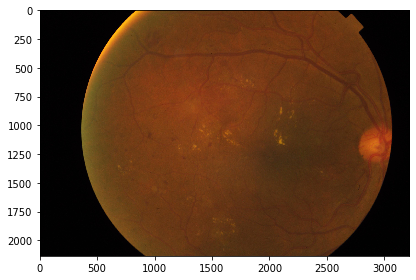

In [4]:
import scipy
from skimage.io import imread, imshow

DIR = '../input/aptos2019-blindness-detection/train_images/'

fundus_df_1 = imread(DIR + fundus_df["img_path"][0])
imshow(fundus_df_1);
print("Diabetic retinopathy grade:", fundus_df["diagnosis"][0])

In [5]:
# Keep balanced the proportions of the classes
# Source: https://towardsdatascience.com/3-things-you-need-to-know-before-you-train-test-split-869dfabb7e50

from sklearn.model_selection import train_test_split

dataframe_indices = list(range(len(fundus_df)))
train_ind, test_ind = train_test_split(dataframe_indices, test_size=0.2)

train_df = fundus_df.iloc[train_ind, :]
test_df = fundus_df.iloc[test_ind, :]

In [6]:
train_df.reset_index(drop=True, inplace=True)
test_df.reset_index(drop=True, inplace=True)

In [7]:
train_df.head()

,id_code,diagnosis,img_path
0,64eb5a79dfdd,1,64eb5a79dfdd.png
1,0d8f60ed9280,0,0d8f60ed9280.png
2,6c00dd8bf708,0,6c00dd8bf708.png
3,115e42dd6a81,2,115e42dd6a81.png
4,28751f290ba3,0,28751f290ba3.png


In [8]:
train_df['img_path'][0]

'64eb5a79dfdd.png'

Diabetic retinopathy grade: 1


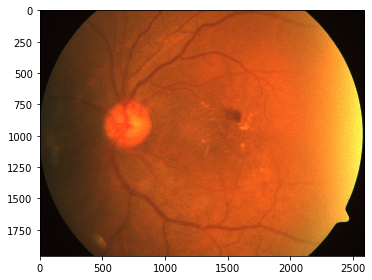

In [9]:
train_df_1 = imread(DIR + train_df["img_path"][0])
imshow(train_df_1);
print("Diabetic retinopathy grade:", train_df["diagnosis"][0])

Diabetic retinopathy grade: 0


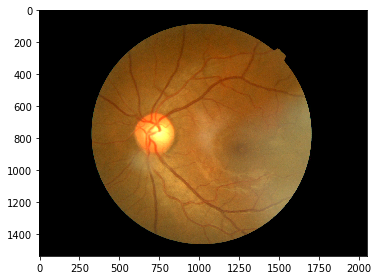

In [10]:
test_df_1 = imread(DIR + test_df["img_path"][0])
imshow(test_df_1);
print("Diabetic retinopathy grade:", test_df["diagnosis"][0])

In [11]:
epochs       = 50 
img_size     = 384
IMG_SIZE = (384,384)
batch_size   = 8
class_number = 5
use_cut_mix  = True
AUTOTUNE = tf.data.AUTOTUNE

from keras.preprocessing.image import ImageDataGenerator
from keras.applications.efficientnet import preprocess_input

# Define generators
train_datagen = ImageDataGenerator( rescale=None, 
                                    preprocessing_function=preprocess_input,
                                    horizontal_flip = True, 
                                    vertical_flip = False,
                                    height_shift_range= 0.1, 
                                    width_shift_range=0.1, 
                                    rotation_range=20,
                                    shear_range = 0.1,
                                    zoom_range=0.1)

test_datagen = ImageDataGenerator(rescale=None, 
                                 preprocessing_function=preprocess_input) 

train_gen = train_datagen.flow_from_dataframe(train_df,
                                              directory="../input/aptos2019-blindness-detection/train_images/",
                                              x_col="img_path",
                                              y_col="diagnosis",
                                              subset="training",
                                              batch_size=batch_size,
                                              class_mode = 'sparse',
                                              shuffle=True,
                                              target_size = IMG_SIZE)

val_gen = test_datagen.flow_from_dataframe(test_df,
                                          directory="../input/aptos2019-blindness-detection/train_images/",
                                          x_col="img_path",
                                          y_col="diagnosis",
                                          batch_size=batch_size,
                                          class_mode = 'sparse',
                                          shuffle=False,
                                          target_size = IMG_SIZE)

Found 2929 validated image filenames belonging to 5 classes.
Found 733 validated image filenames belonging to 5 classes.


In [12]:
class_names = ['noDR', 'mild', 'moderate', 'severe', 'proliferative']

# Modeling

We will use **efficientnet** model and it's embeddings at layer `block6a_expand_activation` as an input of **swin-transformer**. The input shape of model **efficientnet** would be `384` and thus we will get output size `24` at layer `block6a_expand_activation`. And this will be the input of **swin-vit**. 

In [13]:
patch_size      = (2,2)  # 4-by-4 sized patches
dropout_rate    = 0.5     # Dropout rate
num_heads       = 8       # Attention heads
embed_dim       = 64      # Embedding dimension
num_mlp         = 128     # MLP layer size
qkv_bias        = True    # Convert embedded patches to query, key, and values with a learnable additive value
window_size     = 2       # Size of attention window
shift_size      = 1       # Size of shifting window
image_dimension = 24      # Initial image size / Input size of the transformer model 

num_patch_x = image_dimension // patch_size[0]
num_patch_y = image_dimension // patch_size[1]

In [14]:
num_patch_x, num_patch_y

(12, 12)

In [15]:
"""for l in tf.keras.applications.EfficientNetB2(
             include_top=False,
             weights=None,
             input_tensor=tf.keras.Input(shape=(384, 384, 3))
         ).layers:
     print(l.name, l.output_shape)
"""

'for l in tf.keras.applications.EfficientNetB2(\n             include_top=False,\n             weights=None,\n             input_tensor=tf.keras.Input(shape=(384, 384, 3))\n         ).layers:\n     print(l.name, l.output_shape)\n'

### Swin-Transformer Stuff

- [Swin Transformer: Hierarchical Vision Transformer using Shifted Windows](https://arxiv.org/pdf/2103.14030.pdf)

![image](https://user-images.githubusercontent.com/17668390/145635292-0e439077-7695-4cd6-8a41-8ba259f08ec4.png)

In [16]:
def window_partition(x, window_size):
    _, height, width, channels = x.shape
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        x, shape=(-1, patch_num_y, window_size, patch_num_x, window_size, channels)
    )
    x = tf.transpose(x, (0, 1, 3, 2, 4, 5))
    windows = tf.reshape(x, shape=(-1, window_size, window_size, channels))
    return windows


def window_reverse(windows, window_size, height, width, channels):
    patch_num_y = height // window_size
    patch_num_x = width // window_size
    x = tf.reshape(
        windows,
        shape=(-1, patch_num_y, patch_num_x, window_size, window_size, channels),
    )
    x = tf.transpose(x, perm=(0, 1, 3, 2, 4, 5))
    x = tf.reshape(x, shape=(-1, height, width, channels))
    return x


class DropPath(layers.Layer):
    def __init__(self, drop_prob=None, **kwargs):
        super(DropPath, self).__init__(**kwargs)
        self.drop_prob = drop_prob

    def call(self, x):
        input_shape = tf.shape(x)
        batch_size = input_shape[0]
        rank = x.shape.rank
        shape = (batch_size,) + (1,) * (rank - 1)
        random_tensor = (1 - self.drop_prob) + tf.random.uniform(shape, dtype=x.dtype)
        path_mask = tf.floor(random_tensor)
        output = tf.math.divide(x, 1 - self.drop_prob) * path_mask
        return output

In [17]:
class WindowAttention(layers.Layer):
    def __init__(
        self, dim, window_size, num_heads, qkv_bias=True, dropout_rate=0.0, **kwargs
    ):
        super(WindowAttention, self).__init__(**kwargs)
        self.dim = dim
        self.window_size = window_size
        self.num_heads = num_heads
        self.scale = (dim // num_heads) ** -0.5
        self.qkv = layers.Dense(dim * 3, use_bias=qkv_bias)
        self.dropout = layers.Dropout(dropout_rate)
        self.proj = layers.Dense(dim)

    def build(self, input_shape):
        num_window_elements = (2 * self.window_size[0] - 1) * (
            2 * self.window_size[1] - 1
        )
        self.relative_position_bias_table = self.add_weight(
            shape=(num_window_elements, self.num_heads),
            initializer=tf.initializers.Zeros(),
            trainable=True,
        )
        coords_h = np.arange(self.window_size[0])
        coords_w = np.arange(self.window_size[1])
        coords_matrix = np.meshgrid(coords_h, coords_w, indexing="ij")
        coords = np.stack(coords_matrix)
        coords_flatten = coords.reshape(2, -1)
        relative_coords = coords_flatten[:, :, None] - coords_flatten[:, None, :]
        relative_coords = relative_coords.transpose([1, 2, 0])
        relative_coords[:, :, 0] += self.window_size[0] - 1
        relative_coords[:, :, 1] += self.window_size[1] - 1
        relative_coords[:, :, 0] *= 2 * self.window_size[1] - 1
        relative_position_index = relative_coords.sum(-1)

        self.relative_position_index = tf.Variable(
            initial_value=tf.convert_to_tensor(relative_position_index), trainable=False
        )

    def call(self, x, mask=None):
        _, size, channels = x.shape
        head_dim = channels // self.num_heads
        x_qkv = self.qkv(x)
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, 3, self.num_heads, head_dim))
        x_qkv = tf.transpose(x_qkv, perm=(2, 0, 3, 1, 4))
        q, k, v = x_qkv[0], x_qkv[1], x_qkv[2]
        q = q * self.scale
        k = tf.transpose(k, perm=(0, 1, 3, 2))
        attn = q @ k

        num_window_elements = self.window_size[0] * self.window_size[1]
        relative_position_index_flat = tf.reshape(
            self.relative_position_index, shape=(-1,)
        )
        relative_position_bias = tf.gather(
            self.relative_position_bias_table, relative_position_index_flat
        )
        relative_position_bias = tf.reshape(
            relative_position_bias, shape=(num_window_elements, num_window_elements, -1)
        )
        relative_position_bias = tf.transpose(relative_position_bias, perm=(2, 0, 1))
        attn = attn + tf.expand_dims(relative_position_bias, axis=0)

        if mask is not None:
            nW = mask.get_shape()[0]
            mask_float = tf.cast(
                tf.expand_dims(tf.expand_dims(mask, axis=1), axis=0), tf.float32
            )
            attn = (
                tf.reshape(attn, shape=(-1, nW, self.num_heads, size, size))
                + mask_float
            )
            attn = tf.reshape(attn, shape=(-1, self.num_heads, size, size))
            attn = keras.activations.softmax(attn, axis=-1)
        else:
            attn = keras.activations.softmax(attn, axis=-1)
        attn = self.dropout(attn)

        x_qkv = attn @ v
        x_qkv = tf.transpose(x_qkv, perm=(0, 2, 1, 3))
        x_qkv = tf.reshape(x_qkv, shape=(-1, size, channels))
        x_qkv = self.proj(x_qkv)
        x_qkv = self.dropout(x_qkv)
        return x_qkv

In [18]:
class SwinTransformer(layers.Layer):
    def __init__(
        self, 
        dim,
        num_patch,
        num_heads,
        window_size=7,
        shift_size=0,
        num_mlp=1024,
        qkv_bias=True,
        dropout_rate=0.0,
        **kwargs,
    ):
        super(SwinTransformer, self).__init__(**kwargs)

        self.dim = dim  # number of input dimensions
        self.num_patch = num_patch  # number of embedded patches
        self.num_heads = num_heads  # number of attention heads
        self.window_size = window_size  # size of window
        self.shift_size = shift_size  # size of window shift
        self.num_mlp = num_mlp  # number of MLP nodes

        self.norm1 = layers.LayerNormalization(epsilon=1e-5)
        self.attn = WindowAttention(
            dim,
            window_size=(self.window_size, self.window_size),
            num_heads=num_heads,
            qkv_bias=qkv_bias,
            dropout_rate=dropout_rate,
        )
        self.drop_path = DropPath(dropout_rate)
        self.norm2 = layers.LayerNormalization(epsilon=1e-5)

        self.mlp = keras.Sequential(
            [
                layers.Dense(num_mlp),
                layers.Activation(keras.activations.gelu),
                layers.Dropout(dropout_rate),
                layers.Dense(dim),
                layers.Dropout(dropout_rate),
            ]
        )

        if min(self.num_patch) < self.window_size:
            self.shift_size = 0
            self.window_size = min(self.num_patch)

    def build(self, input_shape):
        if self.shift_size == 0:
            self.attn_mask = None
        else:
            height, width = self.num_patch
            h_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            w_slices = (
                slice(0, -self.window_size),
                slice(-self.window_size, -self.shift_size),
                slice(-self.shift_size, None),
            )
            mask_array = np.zeros((1, height, width, 1))
            count = 0
            for h in h_slices:
                for w in w_slices:
                    mask_array[:, h, w, :] = count
                    count += 1
            mask_array = tf.convert_to_tensor(mask_array)

            # mask array to windows
            mask_windows = window_partition(mask_array, self.window_size)
            mask_windows = tf.reshape(
                mask_windows, shape=[-1, self.window_size * self.window_size]
            )
            attn_mask = tf.expand_dims(mask_windows, axis=1) - tf.expand_dims(
                mask_windows, axis=2
            )
            attn_mask = tf.where(attn_mask != 0, -100.0, attn_mask)
            attn_mask = tf.where(attn_mask == 0, 0.0, attn_mask)
            self.attn_mask = tf.Variable(initial_value=attn_mask, trainable=False)

    def call(self, x):
        height, width = self.num_patch
        _, num_patches_before, channels = x.shape
        x_skip = x
        x = self.norm1(x)
        x = tf.reshape(x, shape=(-1, height, width, channels))
        if self.shift_size > 0:
            shifted_x = tf.roll(
                x, shift=[-self.shift_size, -self.shift_size], axis=[1, 2]
            )
        else:
            shifted_x = x

        x_windows = window_partition(shifted_x, self.window_size)
        x_windows = tf.reshape(
            x_windows, shape=(-1, self.window_size * self.window_size, channels)
        )
        attn_windows = self.attn(x_windows, mask=self.attn_mask)

        attn_windows = tf.reshape(
            attn_windows, shape=(-1, self.window_size, self.window_size, channels)
        )
        shifted_x = window_reverse(
            attn_windows, self.window_size, height, width, channels
        )
        if self.shift_size > 0:
            x = tf.roll(
                shifted_x, shift=[self.shift_size, self.shift_size], axis=[1, 2]
            )
        else:
            x = shifted_x

        x = tf.reshape(x, shape=(-1, height * width, channels))
        x = self.drop_path(x)
        x = x_skip + x
        x_skip = x
        x = self.norm2(x)
        x = self.mlp(x)
        x = self.drop_path(x)
        x = x_skip + x
        return x

In [19]:
class PatchExtract(layers.Layer):
    def __init__(self, patch_size, **kwargs):
        super(PatchExtract, self).__init__(**kwargs)
        self.patch_size_x = patch_size[0]
        self.patch_size_y = patch_size[0]

    def call(self, images):
        batch_size = tf.shape(images)[0]
        patches = tf.image.extract_patches(
            images=images,
            sizes=(1, self.patch_size_x, self.patch_size_y, 1),
            strides=(1, self.patch_size_x, self.patch_size_y, 1),
            rates=(1, 1, 1, 1),
            padding="VALID",
        )
        patch_dim = patches.shape[-1]
        patch_num = patches.shape[1]
        return tf.reshape(patches, (batch_size, patch_num * patch_num, patch_dim))


class PatchEmbedding(layers.Layer):
    def __init__(self, num_patch, embed_dim, **kwargs):
        super(PatchEmbedding, self).__init__(**kwargs)
        self.num_patch = num_patch
        self.proj = layers.Dense(embed_dim)
        self.pos_embed = layers.Embedding(input_dim=num_patch, output_dim=embed_dim)

    def call(self, patch):
        pos = tf.range(start=0, limit=self.num_patch, delta=1)
        return self.proj(patch) + self.pos_embed(pos)


class PatchMerging(tf.keras.layers.Layer):
    def __init__(self, num_patch, embed_dim):
        super(PatchMerging, self).__init__()
        self.num_patch = num_patch
        self.embed_dim = embed_dim
        self.linear_trans = layers.Dense(2 * embed_dim, use_bias=False)

    def call(self, x):
        height, width = self.num_patch
        _, _, C = x.get_shape().as_list()
        x = tf.reshape(x, shape=(-1, height, width, C))
        feat_maps = x
     
        x0 = x[:, 0::2, 0::2, :]
        x1 = x[:, 1::2, 0::2, :]
        x2 = x[:, 0::2, 1::2, :]
        x3 = x[:, 1::2, 1::2, :]
        x = tf.concat((x0, x1, x2, x3), axis=-1)
        x = tf.reshape(x, shape=(-1, (height // 2) * (width // 2), 4 * C))
        return self.linear_trans(x), feat_maps

# Hybrid-Swin-Transformer

In [20]:
import numpy as np 
import tensorflow as tf 
from tensorflow import keras 
from tensorflow.keras import Model, Sequential, Input, layers, applications

In [21]:
BASE_WEIGHTS = '../input/efficientnet-keras-noisystudent-weights-b0b7/'

IMG_NET    = [
    'imagenet/imagenet.notop-b0.h5',
    'imagenet/imagenet.notop-b1.h5',
    'imagenet/imagenet.notop-b2.h5'
]

NOISY_STUD = [
    'noisystudent/noisy.student.notop-b0.h5',
    'noisystudent/noisy.student.notop-b1.h5',
    'noisystudent/noisy.student.notop-b2.h5',
]

ADV_PROB = [
    'advprob/adv.prop.notop-b0.h5',
    'advprob/adv.prop.notop-b1.h5',
    'advprob/adv.prop.notop-b2.h5'
]

(2, 5)


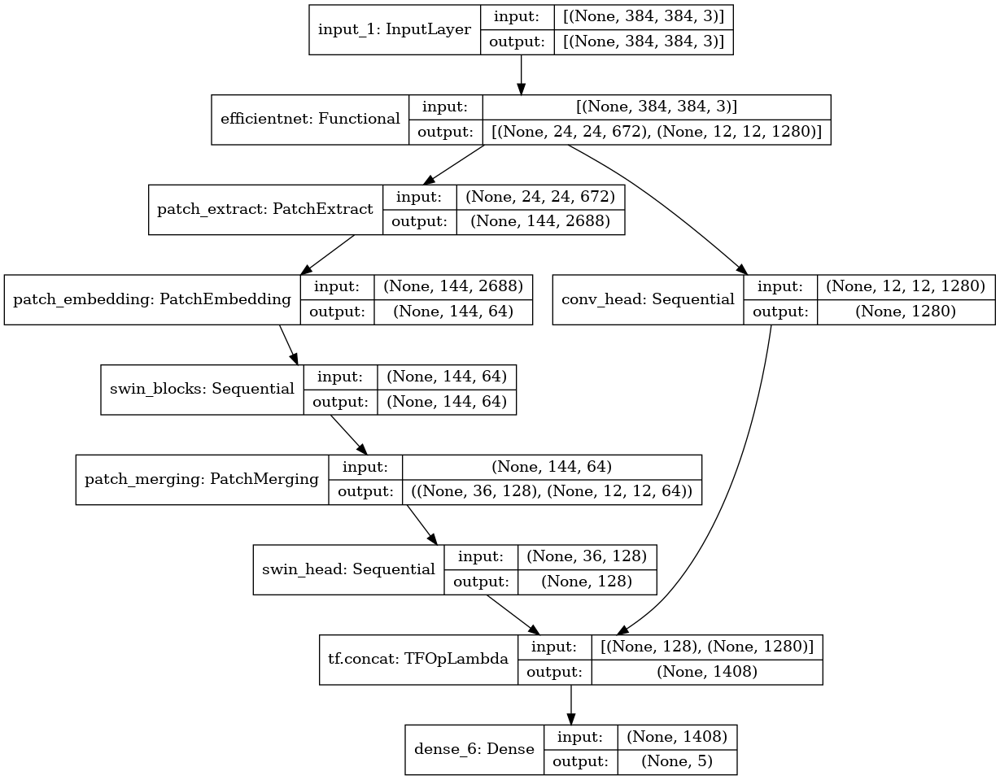

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 384, 384, 3) 0                                            
__________________________________________________________________________________________________
efficientnet (Functional)       [(None, 24, 24, 672) 4049571     input_2[0][0]                    
__________________________________________________________________________________________________
patch_extract (PatchExtract)    (None, 144, 2688)    0           efficientnet[1][0]               
__________________________________________________________________________________________________
patch_embedding (PatchEmbedding (None, 144, 64)      181312      patch_extract[1][0]              
____________________________________________________________________________________________

In [22]:
class HybridSwinTransformer(keras.Model):
    def __init__(self):
        super(HybridSwinTransformer, self).__init__()
        # base models 
        self.inputx = keras.Input((img_size, img_size, 3), name='input_hybrids')
        base = applications.EfficientNetB0(
            include_top=False,
            weights=BASE_WEIGHTS + ADV_PROB[0],
            input_tensor=self.inputx
        )
        
        # base model with compatible output which will be an input of transformer model 
        self.new_base = keras.Model(
            [base.inputs], 
            [
                base.get_layer('block6a_expand_activation').output, 
                base.output
            ], # output with 192 feat_maps
            name='efficientnet'
        )
        
        # stuff of swin transformers 
        self.patch_extract  = PatchExtract(patch_size)
        self.patch_embedds  = PatchEmbedding(num_patch_x * num_patch_y, embed_dim)
        self.patch_merging  = PatchMerging((num_patch_x, num_patch_y), embed_dim=embed_dim)
        
        # swin blocks containers 
        self.swin_sequences = keras.Sequential(name='swin_blocks')
        for i in range(shift_size):
            self.swin_sequences.add(
                SwinTransformer(
                    dim=embed_dim,
                    num_patch=(num_patch_x, num_patch_y),
                    num_heads=num_heads,
                    window_size=window_size,
                    shift_size=i,
                    num_mlp=num_mlp,
                    qkv_bias=qkv_bias,
                    dropout_rate=dropout_rate
                )
            )
        
        # swin block's head
        self.swin_head = keras.Sequential(
            [
                layers.GlobalAveragePooling1D(),
                layers.AlphaDropout(0.5),
                layers.BatchNormalization(),
            ], name='swin_head'
        )
        
        # base model's (cnn model) head
        self.conv_head = keras.Sequential(
            [
                layers.GlobalAveragePooling2D(),
                layers.AlphaDropout(0.5),
            ], name='conv_head'
        )
        
        # classifier
        self.classifier = layers.Dense(class_number, dtype='float32')
        
        
    def call(self, inputs, training=None, **kwargs):
        x , base_gcam_top = self.new_base(inputs)
        x = self.patch_extract(x)
        x = self.patch_embedds(x)
        x = self.swin_sequences(x)
        x, swin_gcam_top = self.patch_merging(x)
        
        swin_top = self.swin_head(x)
        conv_top = self.conv_head(base_gcam_top)
        preds = self.classifier(tf.concat([swin_top, conv_top], axis=-1))
        
        if training: # training phase 
            return preds
        else: # inference phase
            return preds, base_gcam_top, swin_gcam_top

    def build_graph(self):
        x = keras.Input(shape=(img_size, img_size, 3))
        return keras.Model(inputs=[x], outputs=self.call(x))
    
keras.backend.clear_session()
model = HybridSwinTransformer()
print(model(tf.ones((2, img_size, img_size, 3)))[0].shape)
display(keras.utils.plot_model(model.build_graph(), 
                               show_shapes=True,
                               show_layer_names=True, 
                               expand_nested=False))
model.build_graph().summary()

In [23]:
from tensorflow.keras import losses, optimizers , metrics
from tensorflow.keras import callbacks
from tensorflow_addons import optimizers as tfa_optimizers

rlr = callbacks.ReduceLROnPlateau(monitor="val_accuracy", factor=0.3, patience=4)
ckp = callbacks.ModelCheckpoint('model.h5', 
                                monitor="val_accuracy", 
                                verbose=1,
                                save_best_only=True, 
                                save_weights_only=True,
                                mode="max")
log = callbacks.CSVLogger('history.csv', separator=",", append=False)

In [24]:
# compile and run 
loss_fn = losses.SparseCategoricalCrossentropy(from_logits=True) 

In [25]:
# compile and run
model.compile(
    loss=loss_fn,
    optimizer=tfa_optimizers.AdamW(learning_rate=1e-4, weight_decay=0.00001), 
    metrics=['accuracy']
)

# ISSUE: ValueError: Unable to create dataset (name already exists)
# [ugly workaround!]
for i in range(len(model.weights)):
    model.weights[i]._handle_name = model.weights[i].name +  str(i)

In [26]:
# training 
history = model.fit(train_gen, 
                    epochs=epochs,
                    callbacks=[ckp, rlr, log], 
                    validation_data=val_gen, 
                    verbose=0)


Epoch 00001: val_accuracy improved from -inf to 0.73806, saving model to model.h5

Epoch 00002: val_accuracy improved from 0.73806 to 0.77080, saving model to model.h5

Epoch 00003: val_accuracy improved from 0.77080 to 0.81310, saving model to model.h5

Epoch 00004: val_accuracy did not improve from 0.81310

Epoch 00005: val_accuracy improved from 0.81310 to 0.82265, saving model to model.h5

Epoch 00006: val_accuracy did not improve from 0.82265

Epoch 00007: val_accuracy improved from 0.82265 to 0.84447, saving model to model.h5

Epoch 00008: val_accuracy improved from 0.84447 to 0.84720, saving model to model.h5

Epoch 00009: val_accuracy improved from 0.84720 to 0.85675, saving model to model.h5

Epoch 00010: val_accuracy did not improve from 0.85675

Epoch 00011: val_accuracy did not improve from 0.85675

Epoch 00012: val_accuracy did not improve from 0.85675

Epoch 00013: val_accuracy did not improve from 0.85675

Epoch 00014: val_accuracy did not improve from 0.85675

Epoch 00

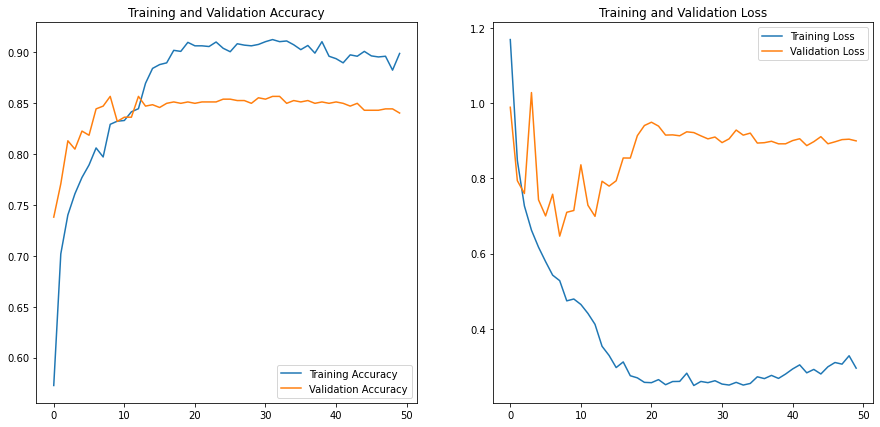

In [27]:
acc     = history.history['accuracy'] 
val_acc = history.history['val_accuracy'] 

loss     = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(15, 7))
plt.subplot(1, 2, 1)
plt.plot(range(epochs), acc, label='Training Accuracy')
plt.plot(range(epochs), val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(range(epochs), loss, label='Training Loss')
plt.plot(range(epochs), val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

# Grad-CAM : Hybrid-Swin-Transformer

In [28]:
def plot_stuff(inputs, features_a, features_b):
    plt.figure(figsize=(25, 25))
    
    plt.subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(tf.squeeze(inputs/255, axis=0))
    plt.title('Input')
    
    plt.subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(features_a)
    plt.title('CNN')
    
    plt.subplot(1, 3, 3)
    plt.axis('off')
    plt.imshow(features_b)
    plt.title('Hybrid-CNN-Transformer')
    plt.show()

# ref: https://keras.io/examples/vision/grad_cam/
def get_img_array(img):
    array = keras.utils.img_to_array(img)
    array = np.expand_dims(array, axis=0)
    return array

# ref: https://keras.io/examples/vision/grad_cam/
def make_gradcam_heatmap(img_array, grad_model, pred_index=None):
    with tf.GradientTape(persistent=True) as tape:
        preds, base_top, swin_top = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
        
    grads = tape.gradient(class_channel, base_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    base_top = base_top[0]
    heatmap_a = base_top @ pooled_grads[..., tf.newaxis]
    heatmap_a = tf.squeeze(heatmap_a)
    heatmap_a = tf.maximum(heatmap_a, 0) / tf.math.reduce_max(heatmap_a)
    heatmap_a = heatmap_a.numpy()
    
    grads = tape.gradient(class_channel, swin_top)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    swin_top = swin_top[0]
    heatmap_b = swin_top @ pooled_grads[..., tf.newaxis]
    heatmap_b = tf.squeeze(heatmap_b)
    heatmap_b = tf.maximum(heatmap_b, 0) / tf.math.reduce_max(heatmap_b)
    heatmap_b = heatmap_b.numpy()
    return heatmap_a, heatmap_b

(8, 384, 384, 3)
(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


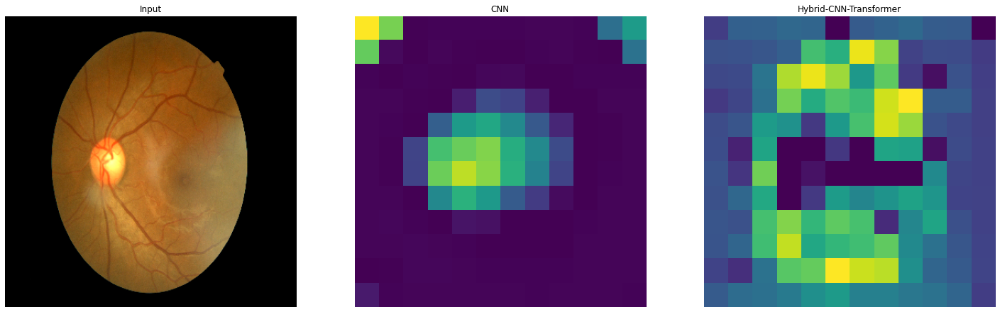

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


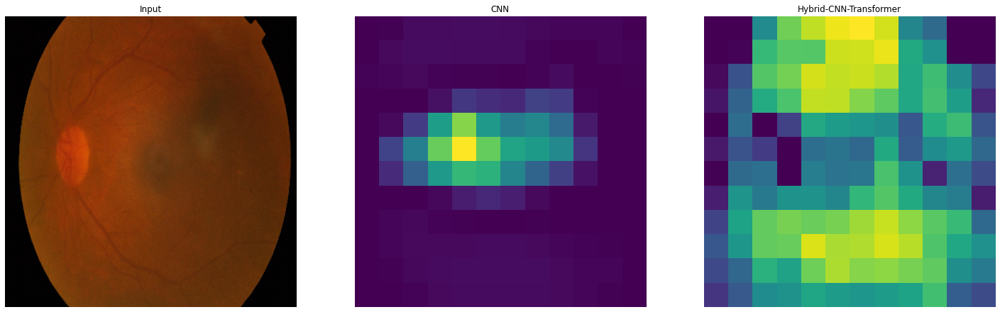

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


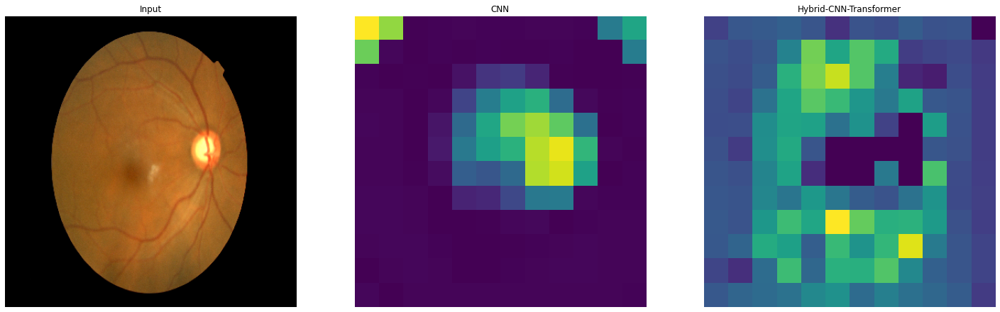

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


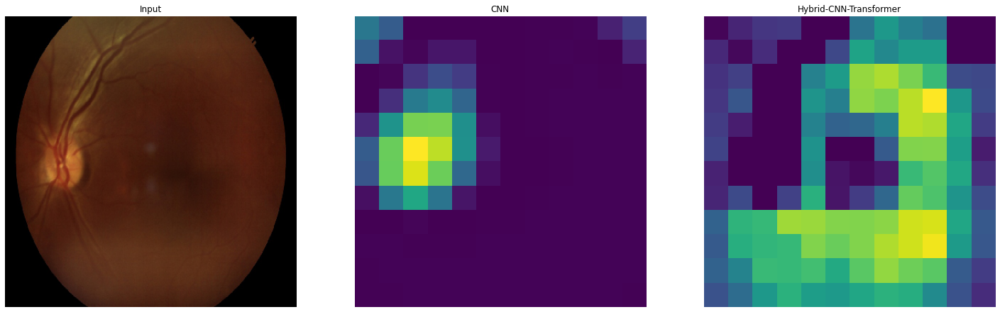

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


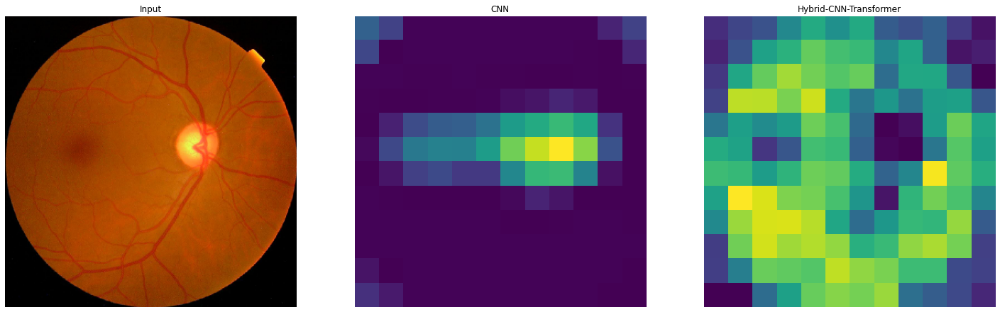

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


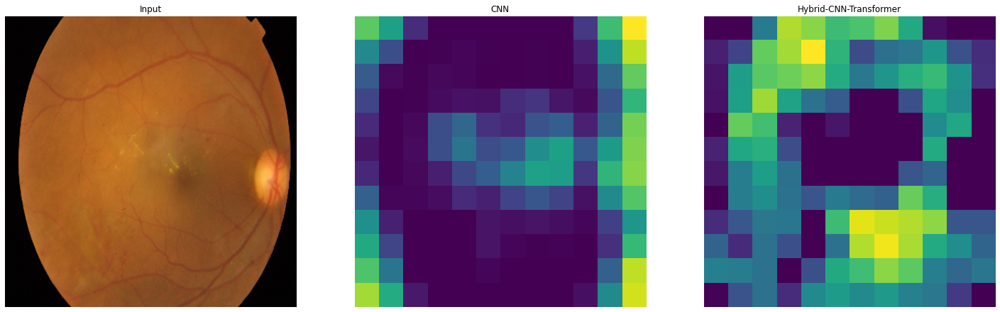

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


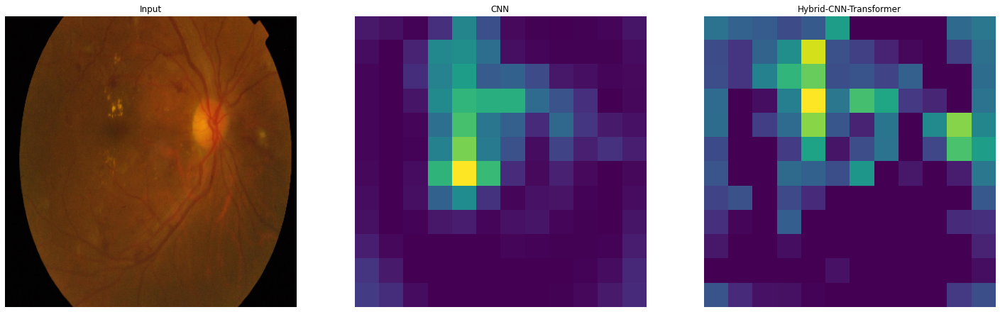

(12, 12) 1.0 0.0
(12, 12) 1.0 0.0


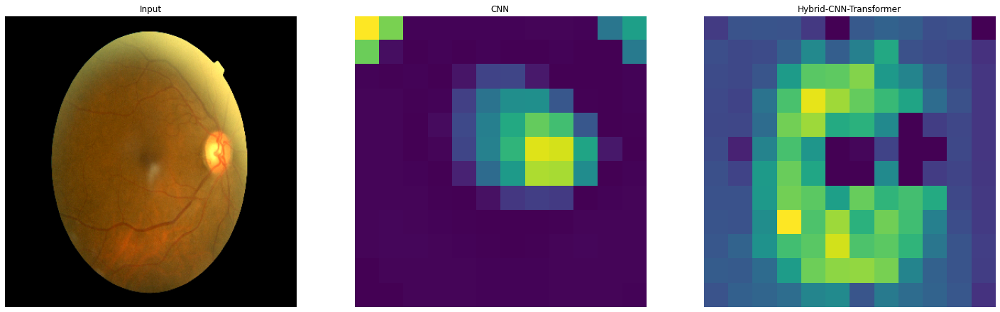

In [29]:
# load save weight
model.load_weights('./model.h5')

# Prepare image
img_arrays = next(iter(val_gen))[0]; print(img_arrays.shape)

# plot utils
for img_array in img_arrays:
    # Generate class activation heatmap
    img_array = get_img_array(img_array)
    cnn_heatmap, swin_heatmap = make_gradcam_heatmap(img_array, model) 
    print(cnn_heatmap.shape, cnn_heatmap.max(), cnn_heatmap.min())
    print(swin_heatmap.shape, swin_heatmap.max(), swin_heatmap.min())
    
    # Display heatmap
    plot_stuff(img_array, cnn_heatmap, swin_heatmap)

In [30]:
# ref: https://keras.io/examples/vision/grad_cam/
def save_and_display_gradcam(img, 
                             heatmap, 
                             target=None, 
                             pred=None,
                             cam_path="cam.jpg",  
                             alpha=0.6, 
                             plot=None):
    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet") 

    # Use RGB values of the colormap
    jet_colors  = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[0], img.shape[1]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = img + jet_heatmap * alpha
    superimposed_img = keras.utils.array_to_img(superimposed_img)
    return superimposed_img

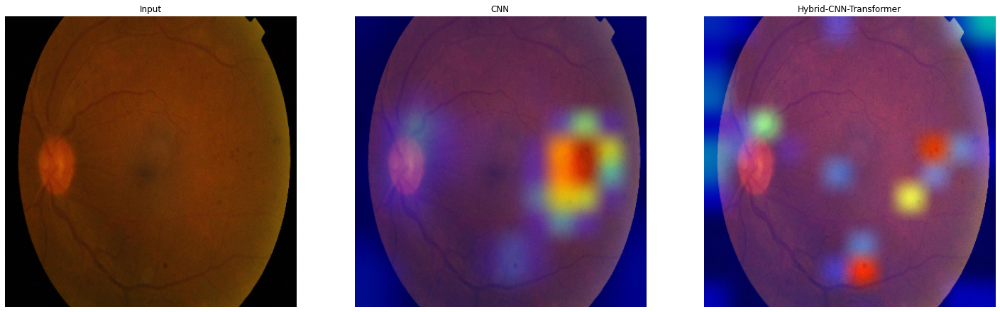

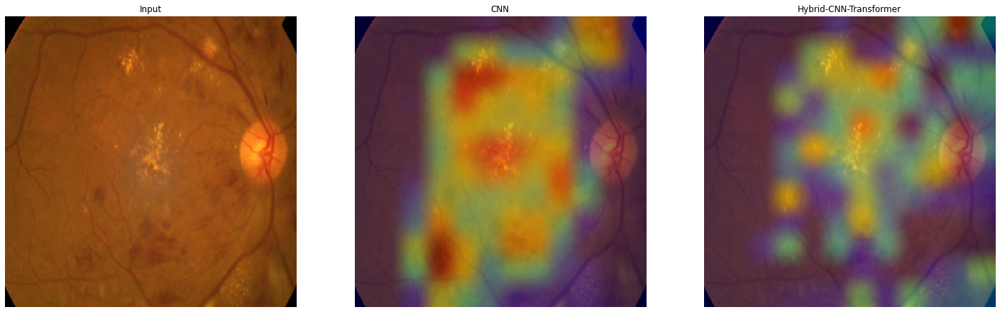

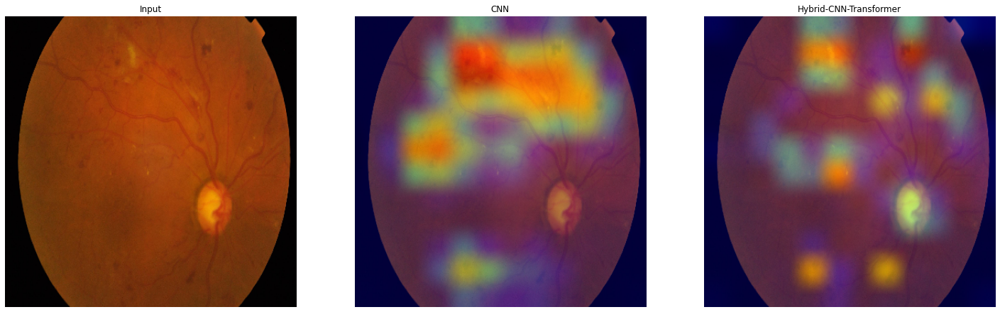

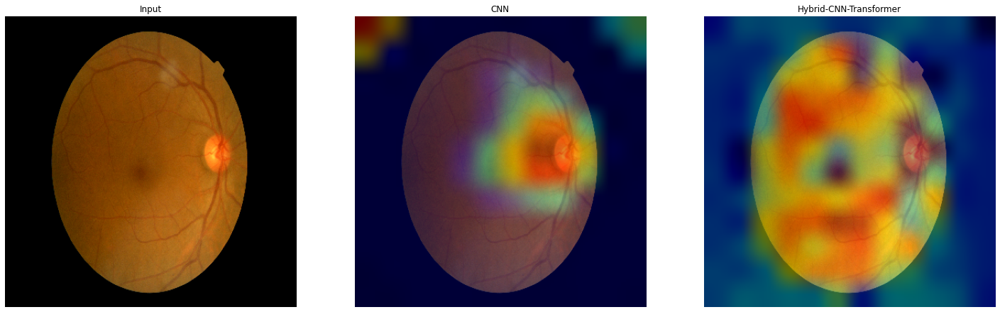

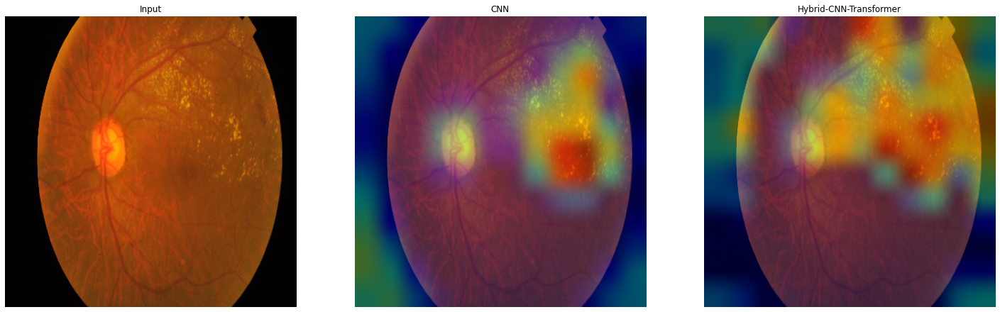

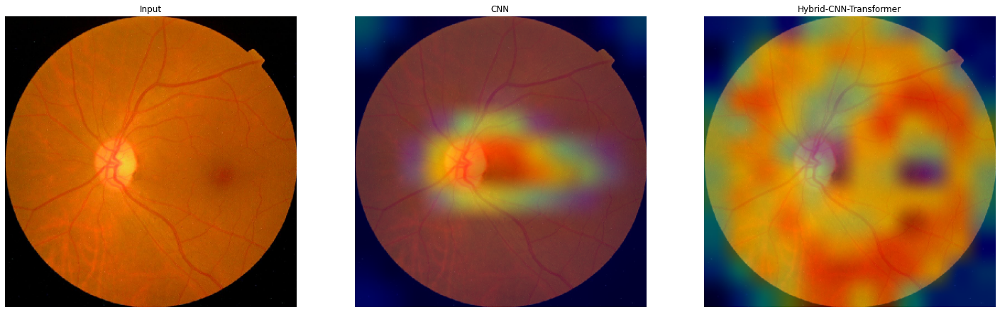

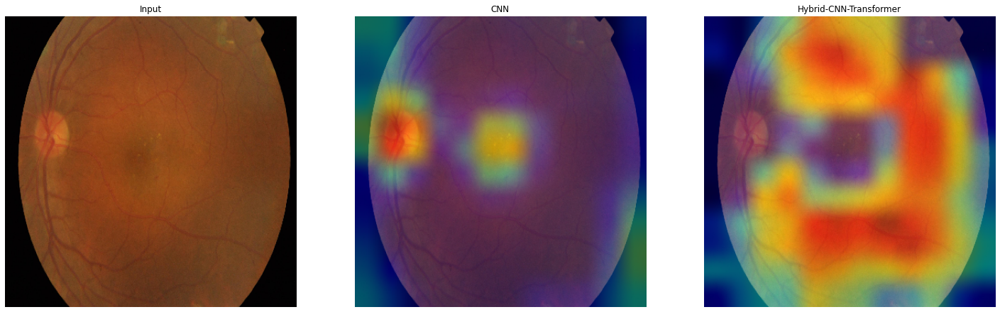

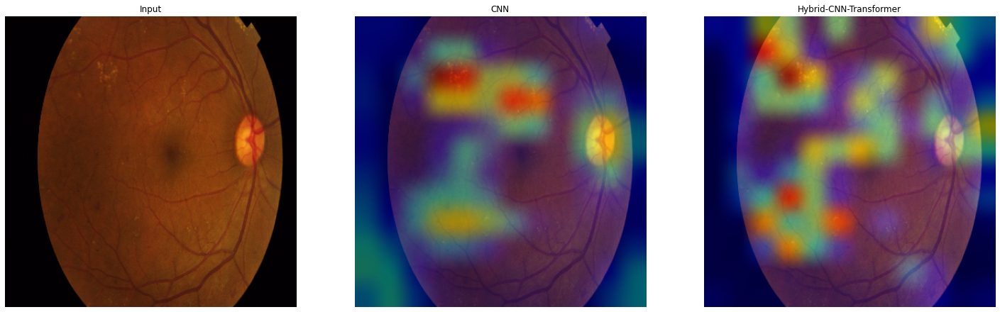

In [31]:
samples, labels = next(iter(val_gen))

for sample, label in zip(samples, labels):
    # preparing 
    img_array = sample[tf.newaxis, ...] 
    
    # get heatmaps 
    heatmap_a, heatmap_b = make_gradcam_heatmap(img_array, model)
    
    # overaly heatmap and input sample 
    overaly_a = save_and_display_gradcam(sample, heatmap_a)
    overlay_b = save_and_display_gradcam(sample, heatmap_b)
    
    # ploting stuff 
    plot_stuff(img_array, overaly_a, overlay_b)

In [49]:
import sklearn
from sklearn.preprocessing import binarize
from sklearn.metrics import roc_curve, auc, precision_recall_curve, average_precision_score, plot_precision_recall_curve, f1_score, confusion_matrix

scores = model.evaluate(val_gen, verbose=0)
print(f'Score: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')

# Calculate the evaluation metrics
pred_Y = model.predict(val_gen, verbose = 0) 

Score: loss of 0.7048044204711914; accuracy of 85.67530512809753%


In [51]:
preds, base_gcam_top, swin_gcam_top = pred_Y
print("----Calculating the evaluation metrics----")
t_y, p_y = val_gen.labels, [np.argmax(pred) for pred in preds]

----Calculating the evaluation metrics----


In [53]:
filenames_path = val_gen.filenames

index_diff, index_same = [], []
for i, t, p in zip(range(len(t_y)), t_y, p_y):
    if  t != p:
        index_diff.append(i)
    else:
        index_same.append(i)
        
predictions = [int(p.item(0)) for p in p_y]
filenamepath_diff = [filenames_path[i] for i in index_diff]
ground_truth_diff = [t_y[i] for i in index_diff]
predictions_diff = [predictions[i] for i in index_diff]
diff_pred_df = {"Ground_Truth": ground_truth_diff,
                 "Prediction": predictions_diff,
                 "Filename_Path": filenamepath_diff}
df_diff = pd.DataFrame(diff_pred_df)
df_diff.to_csv("./hybrid_EffNet_swintf_failure.csv") 

In [55]:
filenamepath_same = [filenames_path[i] for i in index_same]
ground_truth_same = [t_y[i] for i in index_same]
predictions_same = [predictions[i] for i in index_same]
same_pred_df = {"Ground_Truth": ground_truth_same,
                 "Prediction": predictions_same,
                 "Filename_Path": filenamepath_same}
df_same = pd.DataFrame(same_pred_df)
df_same.to_csv("hybrid_EffNet_swintf_sucess.csv") 

In [57]:
!ls ./

__notebook_source__.ipynb  hybrid_EffNet_swintf_failure.csv  model.png
history.csv		   hybrid_EffNet_swintf_sucess.csv
hybrid_EffNet_swintf.csv   model.h5


In [58]:
# The model made ~6% errors over the val set
df_diff.shape, df_same.shape

((106, 3), (627, 3))

In [60]:
val_gen.class_indices

{'0': 0, '1': 1, '2': 2, '3': 3, '4': 4}

# Confusion Matrix

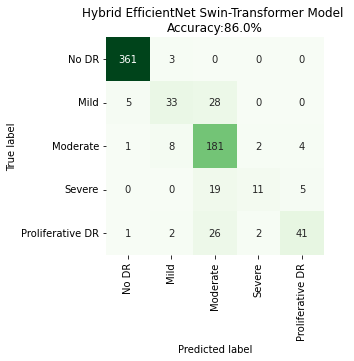

In [61]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Creates a confusion matrix
cm = confusion_matrix(t_y, p_y) 

# Transform to df for easier plotting
cm_df = pd.DataFrame(cm,
                     index = ["No DR", "Mild", "Moderate", "Severe", "Proliferative DR"], 
                     columns = ["No DR", "Mild", "Moderate", "Severe", "Proliferative DR"])

plt.figure(figsize=(6,4))
sns.heatmap(cm_df, square=True, annot=True, cmap="Greens", fmt='d', cbar=False)
plt.title('Hybrid EfficientNet Swin-Transformer Model \nAccuracy:{}%'.format(np.rint(sklearn.metrics.accuracy_score(t_y, p_y)*100)))
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.show()

In [62]:
df_diff.head()

,Ground_Truth,Prediction,Filename_Path
0,4,2,753b14c27c83.png
1,4,1,eaa0dfbd5024.png
2,1,2,495255c7492f.png
3,1,2,07a1c7073982.png
4,1,2,9ed666e982cd.png


In [63]:
df_same.head()

,Ground_Truth,Prediction,Filename_Path
0,0,0,c755a0c4edcc.png
1,0,0,75a4343b12f9.png
2,0,0,de4cdabbce6d.png
3,0,0,441848e0f308.png
4,0,0,6c9c902a97de.png


# Failures

In [67]:
Mild = df_diff[df_diff["Ground_Truth"] == 1]
Mild.head()

,Ground_Truth,Prediction,Filename_Path
2,1,2,495255c7492f.png
3,1,2,07a1c7073982.png
4,1,2,9ed666e982cd.png
7,1,2,84a72e15b23c.png
10,1,0,5b0e53f53ef3.png


In [73]:
# 1 confused with 0 and 2
Mild[(Mild["Prediction"] == 0) | (Mild["Prediction"] == 2)].head(10)

,Ground_Truth,Prediction,Filename_Path
2,1,2,495255c7492f.png
3,1,2,07a1c7073982.png
4,1,2,9ed666e982cd.png
7,1,2,84a72e15b23c.png
10,1,0,5b0e53f53ef3.png
13,1,2,c0968d41eb93.png
17,1,2,d66ccb75ada1.png
21,1,2,29b52f64d2db.png
34,1,2,fd62bd0db4f1.png
38,1,0,b576c5269ad1.png


In [149]:
def plot_toinspect(img_path):
    img = keras.utils.load_img(img_path, target_size=IMG_SIZE)
    img_array = get_img_array(img)
    sample = keras.utils.img_to_array(img)

    # get heatmaps 
    heatmap_a, heatmap_b = make_gradcam_heatmap(img_array, model)

    # overaly heatmap and input sample 
    overaly_a = save_and_display_gradcam(sample, heatmap_a)
    overlay_b = save_and_display_gradcam(sample, heatmap_b)
    # ploting stuff 
    plot_stuff(img_array, overaly_a, overlay_b)

Mild mistaken as Moderate DR


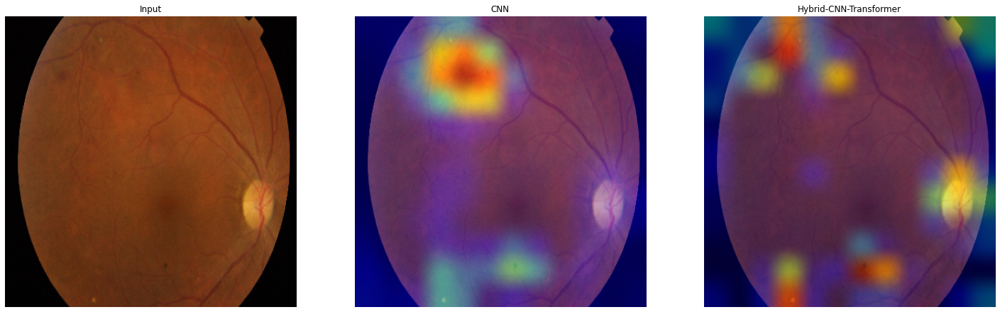

Mild mistaken as Moderate DR


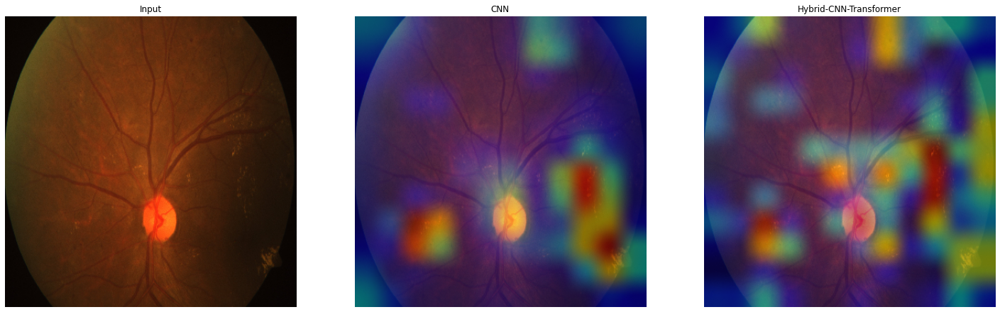

Mild mistaken as No DR


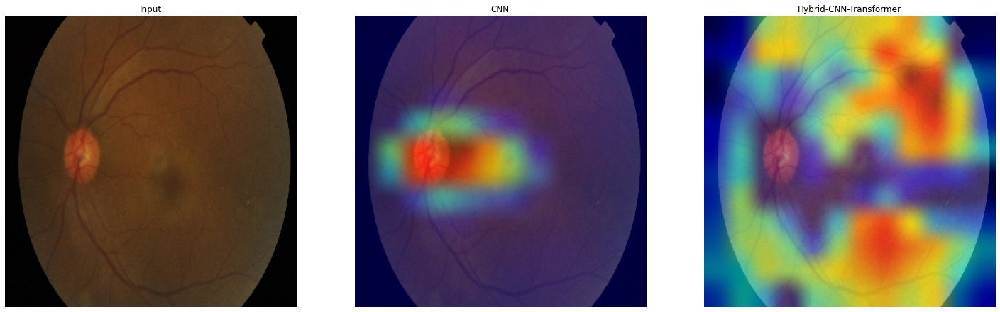

Mild mistaken as No DR


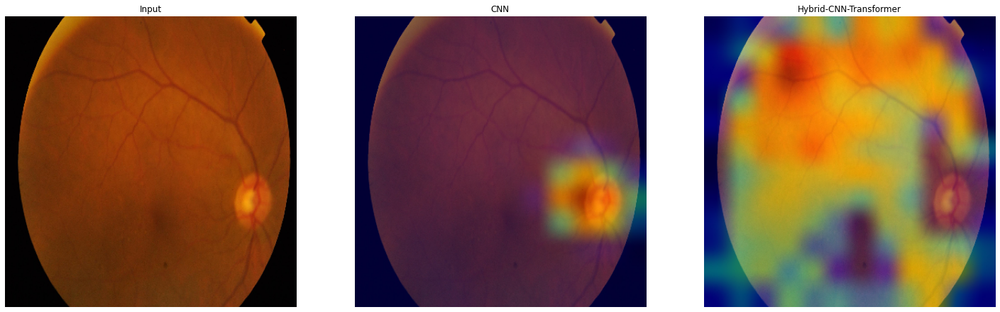

In [153]:
import cv2 as cv
import matplotlib.cm as cm 

count = 0
samples = ["../input/aptos2019-blindness-detection/train_images/"+Mild["Filename_Path"].iloc[i] for i in [0, 1, 4, 9]]
for img_path in samples:
    if count < 2:
        print("Mild mistaken as Moderate DR")
    else:
        print("Mild mistaken as No DR")
    count += 1
    plot_toinspect(img_path)

In [154]:
Moderate = df_diff[df_diff["Ground_Truth"] == 2]
# 2:Moderate confused with 3: severe and 4: PDR
Moderate[(Moderate["Prediction"] == 3) | (Moderate["Prediction"] == 4)].head(10)

,Ground_Truth,Prediction,Filename_Path
26,2,4,041f09eec1e8.png
35,2,4,79be2ff796bf.png
59,2,4,51d780864365.png
65,2,4,77f69c7ff324.png
71,2,3,15cd5f52d300.png
80,2,3,03747397839f.png


In [155]:
Moderate.reset_index(drop=True, inplace=True)
Moderate.head(-2)

,Ground_Truth,Prediction,Filename_Path
0,2,1,8860c7b11530.png
1,2,4,041f09eec1e8.png
2,2,0,f9aa35187bf3.png
3,2,4,79be2ff796bf.png
4,2,1,9ad92f1c1542.png
5,2,1,a804cef3e51f.png
6,2,4,51d780864365.png
7,2,4,77f69c7ff324.png
8,2,1,4246ed634f25.png
9,2,3,15cd5f52d300.png


Moderate mistaken as Severe


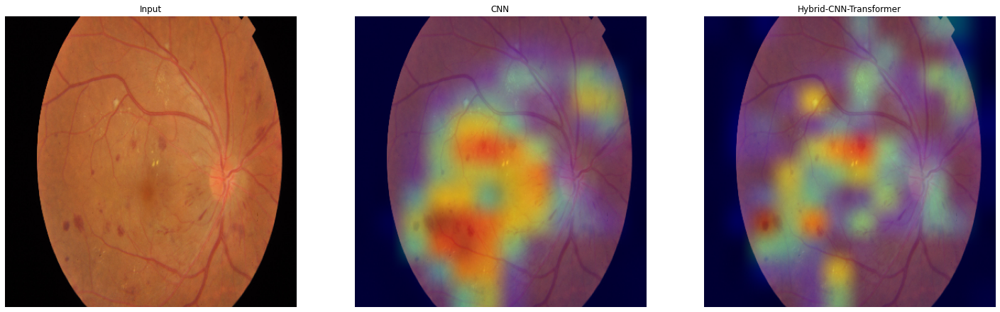

Moderate mistaken as Severe


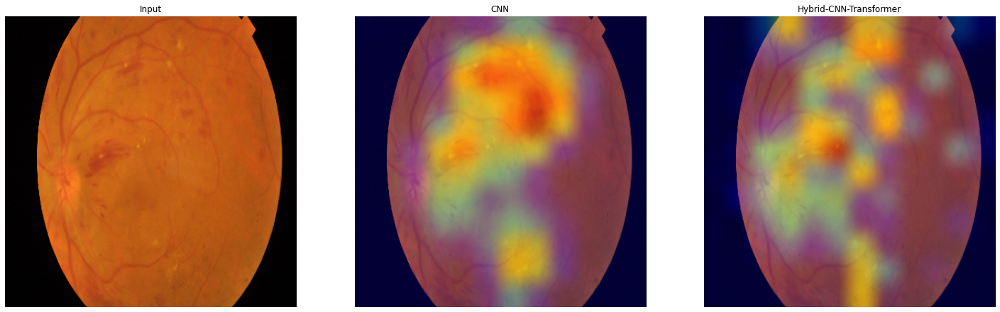

Moderate mistaken as Proliferative DR


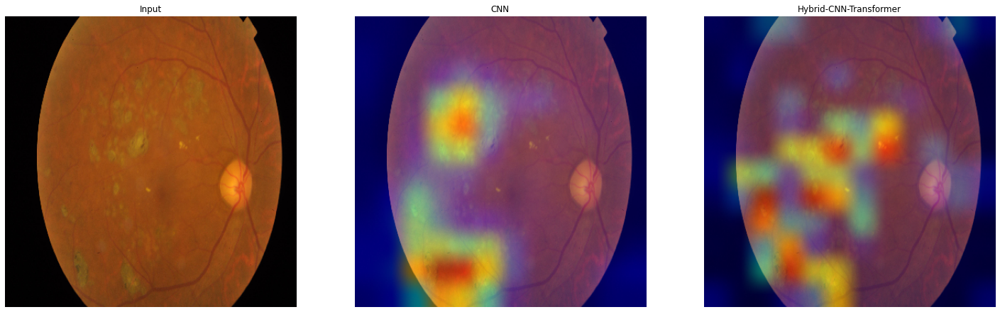

Moderate mistaken as Proliferative DR


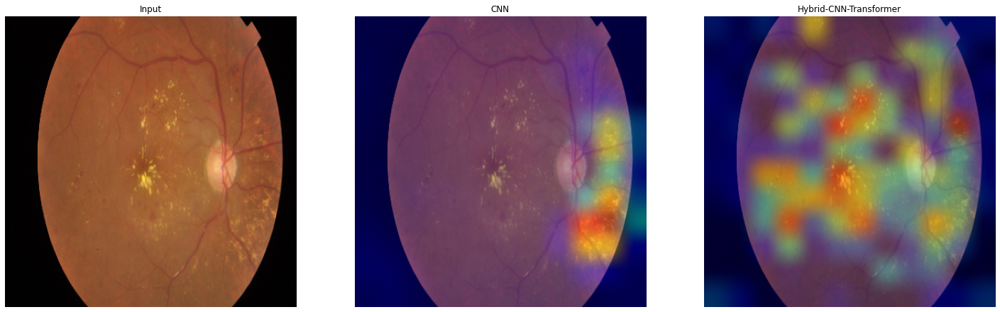

In [157]:
count = 0
samples = ["../input/aptos2019-blindness-detection/train_images/"+Moderate["Filename_Path"].iloc[i] for i in [9, 11, 1, 3]]
for img_path in samples:
    if count < 2:
        print("Moderate mistaken as Severe")
    else:
        print("Moderate mistaken as Proliferative DR")
    count += 1
    plot_toinspect(img_path)

In [158]:
Severe = df_diff[df_diff["Ground_Truth"] == 3]
# 3 confused with 0 and 2
Severe[(Severe["Prediction"] == 2) | (Severe["Prediction"] == 4)]
Severe.reset_index(drop=True, inplace=True)
Severe.head(-5)

,Ground_Truth,Prediction,Filename_Path
0,3,2,f901d460517c.png
1,3,2,4df6a81b476e.png
2,3,2,6735931000ec.png
3,3,2,6089fa333013.png
4,3,2,f6f433f3306f.png
5,3,2,8c0d05233238.png
6,3,2,9fefe2b44795.png
7,3,2,4c570172778b.png
8,3,2,6d0c0531083f.png
9,3,2,8201cab8322d.png


Severe mistaken as Moderate DR


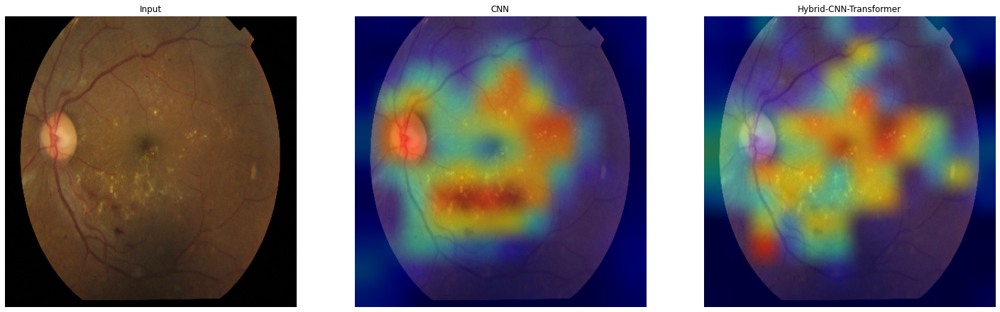

Severe mistaken as Moderate DR


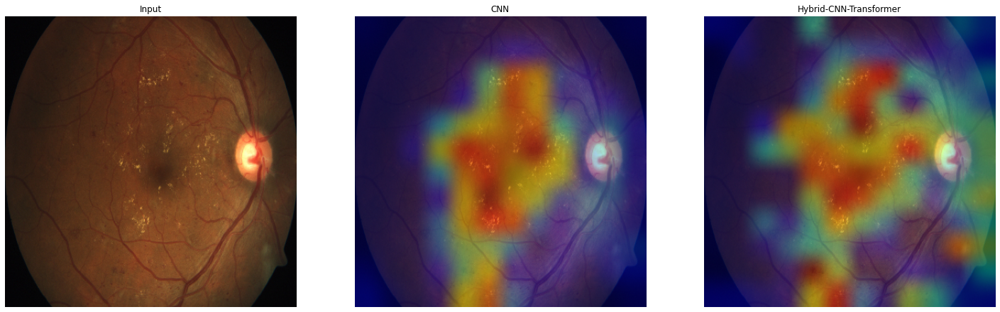

Severe mistaken as Proliferative DR


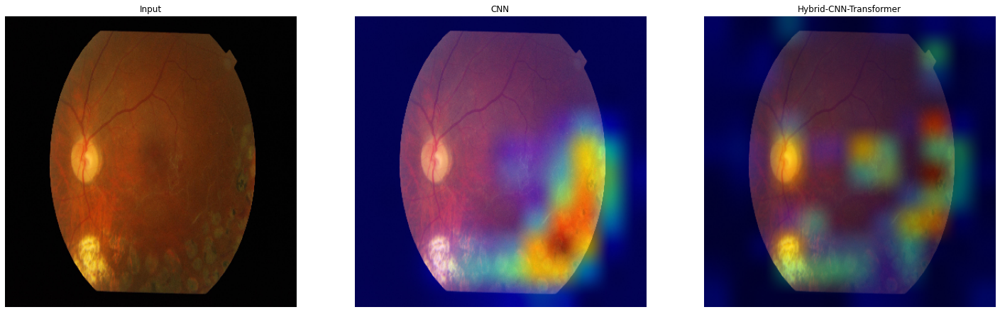

Severe mistaken as Proliferative DR


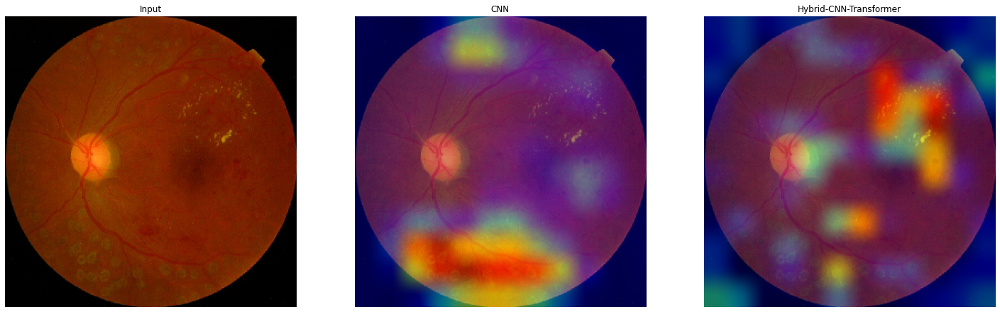

In [161]:
count = 0
samples = ["../input/aptos2019-blindness-detection/train_images/"+Severe["Filename_Path"].iloc[i] for i in [0, 1, 12, 18]]
for img_path in samples:
    if count < 2:
        print("Severe mistaken as Moderate DR")
    else:
        print("Severe mistaken as Proliferative DR")
    count += 1
    plot_toinspect(img_path)

In [164]:
df_same[df_same["Prediction"] == 0].head()

,Ground_Truth,Prediction,Filename_Path
0,0,0,c755a0c4edcc.png
1,0,0,75a4343b12f9.png
2,0,0,de4cdabbce6d.png
3,0,0,441848e0f308.png
4,0,0,6c9c902a97de.png


In [165]:
df_same[df_same["Prediction"] == 1].head()

,Ground_Truth,Prediction,Filename_Path
5,1,1,172df1330a60.png
17,1,1,4e82c3c8d31f.png
28,1,1,5879285f9d8d.png
30,1,1,e2a233493b90.png
31,1,1,38b9bb961847.png


In [166]:
df_same[df_same["Prediction"] == 2].head()

,Ground_Truth,Prediction,Filename_Path
6,2,2,5ed6dc419e4d.png
11,2,2,8c87bd748996.png
13,2,2,c1c8550508e0.png
14,2,2,c3acf47700ea.png
16,2,2,7d1da90d3ca9.png


In [167]:
df_same[df_same["Prediction"] == 3].head()

,Ground_Truth,Prediction,Filename_Path
8,3,3,5f13e8a07344.png
9,3,3,3fa4f4d77177.png
69,3,3,c5a9ebef1517.png
156,3,3,7b49041cbf17.png
224,3,3,fcc6aa6755e6.png


In [168]:
df_same[df_same["Prediction"] == 4].head()

,Ground_Truth,Prediction,Filename_Path
18,4,4,a6d45de20e4d.png
35,4,4,873dcc0b468f.png
37,4,4,875a2fc5fe23.png
51,4,4,cf1b9d26d38d.png
52,4,4,64bad93fde3f.png


In [ ]:
[0, 5, 6, 8, 18]

In [171]:
df_same["Filename_Path"].iloc[0]

'c755a0c4edcc.png'

# Sucess

No DR


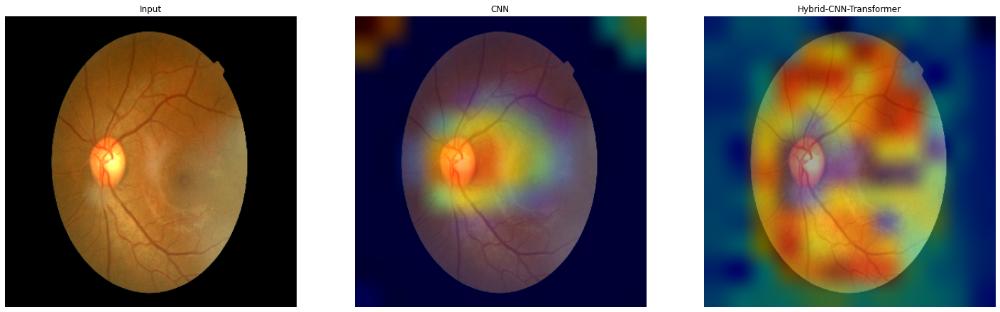

Mild


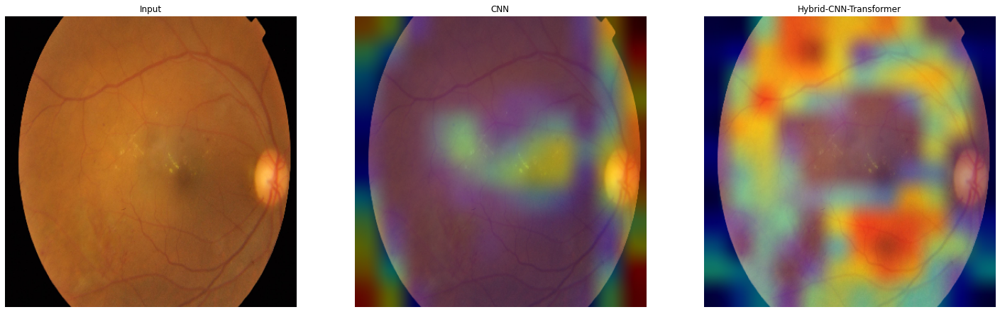

Moderate


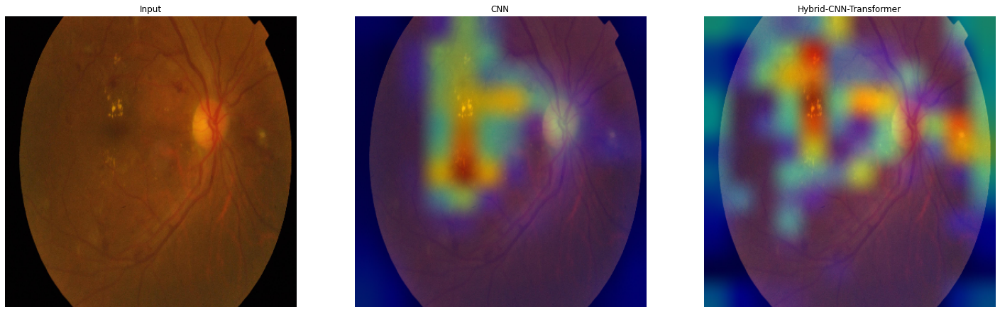

Severe


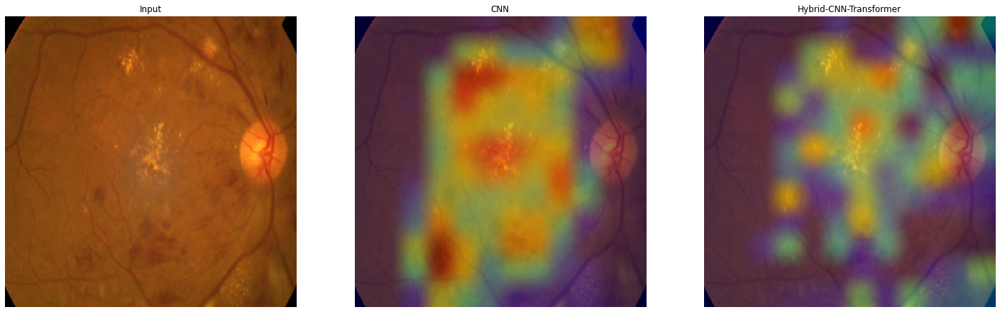

Prolifertive DR


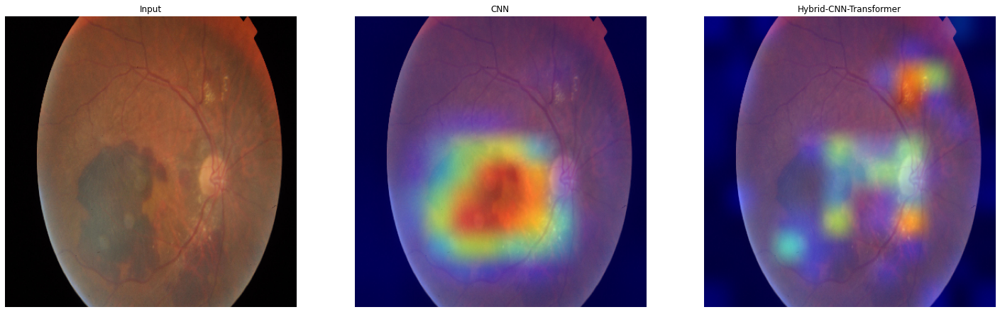

In [172]:
samples = ["../input/aptos2019-blindness-detection/train_images/"+df_same["Filename_Path"].iloc[i] for i in [0, 5, 6, 8, 18]]
print("No DR")
plot_toinspect(samples[0]) # wrong function naming for this one 😅
print("Mild")
plot_toinspect(samples[1])
print("Moderate")
plot_toinspect(samples[2])
print("Severe")
plot_toinspect(samples[3])
print("Prolifertive DR")
plot_toinspect(samples[4])